In [10]:
import pandas as pd
import os
%matplotlib inline
import seaborn
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cmx
import getpass
import json
from IPython.display import display
import geopandas as gpd
from shapely.geometry import Point
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
init_notebook_mode(connected=True)

def pythonise_string(input_string):
    return input_string.lower().replace(' ', '_')

In [11]:
try:
    with open('authentication.json') as f:
        mapbox_access_token = json.load(f)['mapbox_access_token']
except:
    mapbox_access_token = getpass.getpass()

In [12]:
data_path = r'D:\uk_police_crime_data\police_data'
region = 'metropolitan'
data_type = 'street'
start_date = pd.Timestamp(year=2014, month=12, day=1)
end_date = pd.Timestamp(year=2019, month=2, day=1)

map_data_path = r'D:\uk_police_crime_data\map_data\statistical-gis-boundaries-london\ESRI\London_Borough_Excluding_MHW.shp'
crs = {'init': 'epsg:4326'}

In [13]:
data_date_range = pd.date_range(start=start_date, end=end_date, freq='M')
display(data_date_range)

DatetimeIndex(['2014-12-31', '2015-01-31', '2015-02-28', '2015-03-31',
               '2015-04-30', '2015-05-31', '2015-06-30', '2015-07-31',
               '2015-08-31', '2015-09-30', '2015-10-31', '2015-11-30',
               '2015-12-31', '2016-01-31', '2016-02-29', '2016-03-31',
               '2016-04-30', '2016-05-31', '2016-06-30', '2016-07-31',
               '2016-08-31', '2016-09-30', '2016-10-31', '2016-11-30',
               '2016-12-31', '2017-01-31', '2017-02-28', '2017-03-31',
               '2017-04-30', '2017-05-31', '2017-06-30', '2017-07-31',
               '2017-08-31', '2017-09-30', '2017-10-31', '2017-11-30',
               '2017-12-31', '2018-01-31', '2018-02-28', '2018-03-31',
               '2018-04-30', '2018-05-31', '2018-06-30', '2018-07-31',
               '2018-08-31', '2018-09-30', '2018-10-31', '2018-11-30',
               '2018-12-31', '2019-01-31'],
              dtype='datetime64[ns]', freq='M')

In [14]:
def get_data_file_path(date, data_path=data_path, region=region, data_type=data_type):
    return os.path.join(data_path, f'{date:%Y-%m}', f'{date:%Y-%m}-{region}-{data_type}.csv')
    
raw_df = pd.concat([pd.read_csv(get_data_file_path(date)) for date in data_date_range], axis=0).reset_index(drop=True)
display(raw_df.head())

,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context
0,NaN,2014-12,Metropolitan Police Service,Metropolitan Police Service,0.134947,51.588063,On or near Mead Grove,E01000027,Barking and Dagenham 001A,Anti-social behaviour,NaN,NaN
1,NaN,2014-12,Metropolitan Police Service,Metropolitan Police Service,0.140035,51.589112,On or near Beansland Grove,E01000027,Barking and Dagenham 001A,Anti-social behaviour,NaN,NaN
2,d1fb841e44cc811cecf3c6744e3b7d0f1e3bd96b24a441...,2014-12,Metropolitan Police Service,Metropolitan Police Service,0.140035,51.589112,On or near Beansland Grove,E01000027,Barking and Dagenham 001A,Burglary,Investigation complete; no suspect identified,NaN
3,48f91db00f9cb836ebd4b418ccaf490d2647a47fcd16ed...,2014-12,Metropolitan Police Service,Metropolitan Police Service,0.135554,51.584985,On or near Rose Lane,E01000027,Barking and Dagenham 001A,Burglary,Defendant found not guilty,NaN
4,1cefdbd4841090ecfe5b481897497a1426b1c1dd503cfc...,2014-12,Metropolitan Police Service,Metropolitan Police Service,0.133181,51.586719,On or near Rosehatch Avenue,E01000027,Barking and Dagenham 001A,Criminal damage and arson,Under investigation,NaN


In [15]:
def clean_data(input_df):
    df = input_df.copy()
    
    df.columns = [pythonise_string(column) for column in df.columns]
    
    df['date'] = pd.to_datetime(df['month'], format='%Y-%m')
    
    df[['longitude', 'latitude']] = df[['longitude', 'latitude']].round(4)
    
    df = df.loc[~(df['longitude'].isnull() | df['latitude'].isnull())]
    
    drop_columns = ['month', 'falls_within', 'reported_by', 'last_outcome_category', 'context', 'lsoa_code', 'lsoa_name', 
                    'crime_id']
    df = df.drop(columns=drop_columns).reset_index(drop=True)
    
    return df

clean_df = clean_data(raw_df)
display(clean_df['crime_type'].unique())
display(clean_df.head())

array(['Anti-social behaviour', 'Burglary', 'Criminal damage and arson',
       'Drugs', 'Other theft', 'Violence and sexual offences',
       'Other crime', 'Public order', 'Vehicle crime', 'Robbery',
       'Shoplifting', 'Theft from the person', 'Bicycle theft',
       'Possession of weapons'], dtype=object)

,longitude,latitude,location,crime_type,date
0,0.1349,51.5881,On or near Mead Grove,Anti-social behaviour,2014-12-01
1,0.1400,51.5891,On or near Beansland Grove,Anti-social behaviour,2014-12-01
2,0.1400,51.5891,On or near Beansland Grove,Burglary,2014-12-01
3,0.1356,51.5850,On or near Rose Lane,Burglary,2014-12-01
4,0.1332,51.5867,On or near Rosehatch Avenue,Criminal damage and arson,2014-12-01


In [16]:
gdf = clean_df.copy()
gdf['coordinate'] = list(zip(gdf['longitude'], gdf['latitude']))
gdf['coordinate'] = gdf['coordinate'].apply(Point)
gdf = gpd.GeoDataFrame(gdf, crs=crs, geometry='coordinate')
display(gdf.head())
display(gdf.crs)

,longitude,latitude,location,crime_type,date,coordinate
0,0.1349,51.5881,On or near Mead Grove,Anti-social behaviour,2014-12-01,POINT (0.1349 51.5881)
1,0.1400,51.5891,On or near Beansland Grove,Anti-social behaviour,2014-12-01,POINT (0.14 51.5891)
2,0.1400,51.5891,On or near Beansland Grove,Burglary,2014-12-01,POINT (0.14 51.5891)
3,0.1356,51.5850,On or near Rose Lane,Burglary,2014-12-01,POINT (0.1356 51.585)
4,0.1332,51.5867,On or near Rosehatch Avenue,Criminal damage and arson,2014-12-01,POINT (0.1332 51.5867)


{'init': 'epsg:4326'}

In [17]:
map_df = gpd.read_file(map_data_path)
map_df.columns = [pythonise_string(column) for column in map_df.columns]
map_df = map_df.drop(columns=['gss_code', 'sub_2009', 'sub_2006', 'nonld_area', 'ons_inner'])
display(map_df.head())
display(map_df.crs)
map_df = map_df.to_crs(crs)
display(map_df.head())
display(map_df.crs)

,name,hectares,geometry
0,Kingston upon Thames,3726.117,"POLYGON ((516401.6 160201.8, 516407.3 160210.5..."
1,Croydon,8649.441,"POLYGON ((535009.2 159504.7, 535005.5 159502, ..."
2,Bromley,15013.487,"POLYGON ((540373.6 157530.4, 540361.2 157551.9..."
3,Hounslow,5658.541,"POLYGON ((521975.8 178100, 521967.7 178096.8, ..."
4,Ealing,5554.428,"POLYGON ((510253.5 182881.6, 510249.9 182886, ..."


{'init': 'epsg:27700'}

,name,hectares,geometry
0,Kingston upon Thames,3726.117,POLYGON ((-0.3306790624157818 51.3290110112976...
1,Croydon,8649.441,POLYGON ((-0.06402123900956014 51.318637660565...
2,Bromley,15013.487,POLYGON ((0.01213093914344611 51.2995990603405...
3,Hounslow,5658.541,POLYGON ((-0.2445623939692516 51.4887021770822...
4,Ealing,5554.428,POLYGON ((-0.4118326892280499 51.5340838633327...


{'init': 'epsg:4326'}

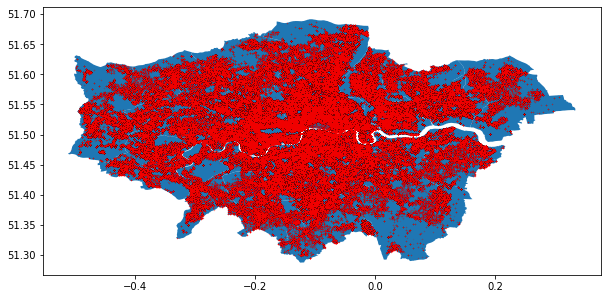

In [18]:
connected_df = gpd.sjoin(map_df, gdf, how="left", op='contains').reset_index(drop=True)
fig, ax = plt.subplots(1, figsize=(10, 6))
map_df.plot(ax=ax)
gdf.loc[connected_df['index_right']].plot(ax=ax, marker='o', color='red', alpha=0.1, markersize=0.1)

In [19]:
count_column_name = 'crime_type'
groupby_columns = ['longitude', 'latitude', 'crime_type']
remaining_column = ['location']
# groupby_columns = ['longitude', 'latitude']


crime_df = clean_df.loc[connected_df['index_right']].groupby(groupby_columns)[remaining_column].count() \
    .unstack('crime_type') \
    .fillna(0) \
    .astype('int64')
crime_df.columns = crime_df.columns.droplevel(0)
crime_df['Total'] = crime_df.sum(axis=1)

display(crime_df.head())

,crime_type,Anti-social behaviour,Bicycle theft,Burglary,Criminal damage and arson,Drugs,Other crime,Other theft,Possession of weapons,Public order,Robbery,Shoplifting,Theft from the person,Vehicle crime,Violence and sexual offences,Total
longitude,latitude,,,,,,,,,,,,,,,
-0.5076,51.4687,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1
-0.5051,51.4745,3,0,0,0,0,0,0,0,0,0,0,0,0,0,3
-0.4977,51.6116,5,0,5,0,0,0,0,0,0,0,0,0,0,1,11
-0.4974,51.6066,0,0,6,0,0,0,0,0,0,0,0,0,3,2,11
-0.4969,51.6138,0,0,2,2,0,0,2,0,0,0,0,0,2,0,8


In [20]:
plot_df = crime_df[['Total']].rename(columns={'Total': 'count'})
plot_df['text'] = crime_df.apply(lambda row: 
                                 str({key: f'{value}<br>' for key, value in row.iteritems() if value != 0}), 
                                 axis=1).str.replace("'|, |{|}", '')
plot_df = plot_df.reset_index()

plot_df['percentile'] = plot_df['count'].rank(pct=True)

# n_sizes = 10
# plot_df['marker_size'] = 5 + plot_df['percentile'] * n_sizes

data = [
    go.Scattermapbox(
        lat=plot_df['latitude'],
        lon=plot_df['longitude'],
        mode='markers',
        marker=go.scattermapbox.Marker(
            size=15, #count_df['marker_size'],
            opacity=.5,
            color=1-plot_df['percentile'],
            colorscale='YlOrRd'
        ),
        text=plot_df['text'],
    )
]


layout = go.Layout(
    autosize=True,
    hovermode='closest',
    mapbox=go.layout.Mapbox(
        accesstoken=mapbox_access_token,
        bearing=0,
        style='streets',
        center=go.layout.mapbox.Center(
            lat=51.509865,
            lon=-0.118092
        ),
        pitch=0,
        zoom=8
    ),
)

fig = go.Figure(data=data, layout=layout)
iplot(fig)